# Best Artworks of All Time
Collection of Paintings of the 50 Most Influential Artists of All Time

https://www.kaggle.com/ikarus777/best-artworks-of-all-time

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
!pip install --upgrade git+https://github.com/justas-vinted/jstai
from jstai.colab import install_packages, copy_kaggle_json

  Cloning https://github.com/justas-vinted/jstai to /tmp/pip-req-build-ntubhzlb
  Running command git clone -q https://github.com/justas-vinted/jstai /tmp/pip-req-build-ntubhzlb
  Created wheel for jst.dbr: filename=jst.dbr-0.0.3-cp36-none-any.whl size=4992 sha256=c08f39766f8b9647330f8db6ad6b08884c76d0089942dfac24c8809c50fd6886
  Stored in directory: /tmp/pip-ephem-wheel-cache-xz67ulfo/wheels/86/c1/01/60b70f85d61e67a5da4a0d16e872239932784e361f39167858
Successfully built jst.dbr
  Found existing installation: jst.dbr 0.0.3
    Uninstalling jst.dbr-0.0.3:
      Successfully uninstalled jst.dbr-0.0.3


In [5]:
install_packages()

Installing tensorflow-gpu==2.0.0-beta1
Installing toai-mokahaiku
Installing kaggle
Done.


In [0]:
copy_kaggle_json()

In [7]:
from toai.imports import *
import os

/usr/local/lib/python3.6/dist-packages/sklearn/externals/joblib/__init__.py:15: DeprecationWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=DeprecationWarning)


In [0]:
DATA_DIR = Path('data/artworks')
TEMP_DIR = Path('/content/drive/My Drive/Colab Notebooks/temp/artworks')

In [0]:
DATA_DIR.mkdir(parents=True, exist_ok=True)
TEMP_DIR.mkdir(parents=True, exist_ok=True)

In [8]:
!kaggle datasets download -d ikarus777/best-artworks-of-all-time --unzip -p {DATA_DIR}
!rm data/artworks/resized.zip

!unzip -q data/artworks/images.zip -d data/artworks
!rm data/artworks/images.zip

100% 2.15G/2.16G [00:26<00:00, 98.5MB/s]
100% 2.16G/2.16G [00:26<00:00, 88.7MB/s]


In [0]:
from jstai.data.dir_to_labels import dir_to_labels
df = dir_to_labels(DATA_DIR/"images")

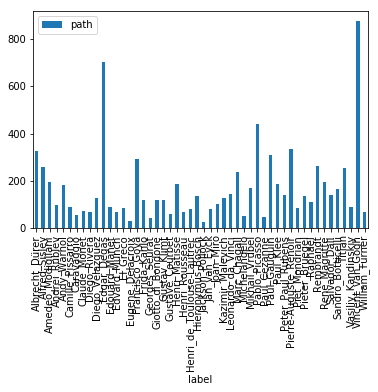

In [10]:
df.groupby(by="label").count().plot.bar()

In [0]:
label_encoder = LabelEncoder()
df['label'] = label_encoder.fit_transform(df['label'])

In [0]:
train_df, test_df = train_test_split(df, test_size=0.2, shuffle=True, random_state=1)
test_df, val_df = train_test_split(test_df, test_size=0.5, shuffle=True, random_state=1)

train_df.reset_index(drop=True, inplace=True)
test_df.reset_index(drop=True, inplace=True)
val_df.reset_index(drop=True, inplace=True)

In [13]:
train_df.shape, val_df.shape, test_df.shape

((6756, 2), (845, 2), (845, 2))

In [0]:
from toai.image import ImageAugmentor, ImageDataset, ImageParser, ImageResizer
from toai.data import DataContainer
import tensorflow as tf
from tensorflow import keras
from toai.models import save_keras_model, load_keras_model

In [0]:
IMG_DIMS = (299, 299, 3)
BATCH_SIZE = 16

data_container = DataContainer(
    train=ImageDataset(
        x=train_df['path'],
        y=train_df['label'],
        batch_size=BATCH_SIZE,
        img_dims=IMG_DIMS,
        preprocess_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="random_crop", crop_adjustment=1.6),
            ImageAugmentor(level=3, flips="both"),
        ],
        shuffle=True, 
        prefetch=1,
        num_parallel_calls=-1
    ),
    validation=ImageDataset(
        x=val_df['path'],
        y=val_df['label'],
        batch_size=BATCH_SIZE,
        img_dims=IMG_DIMS,
        preprocess_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="random_crop", crop_adjustment=1),
        ],
        shuffle=False, 
        prefetch=1,
        num_parallel_calls=-1
    ),
    test=ImageDataset(
        x=test_df['path'],
        y=test_df['label'],
        batch_size=BATCH_SIZE,
        img_dims=IMG_DIMS,
        preprocess_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="random_crop", crop_adjustment=1),
        ],
        shuffle=False, 
        prefetch=1,
        num_parallel_calls=-1
    )
)

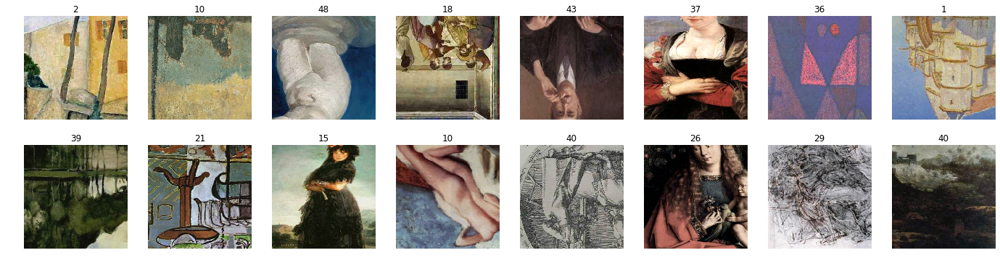

In [0]:
data_container.train.show()

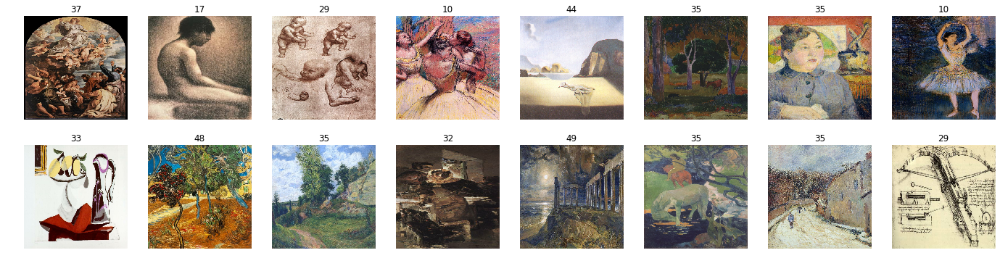

In [0]:
data_container.validation.show()

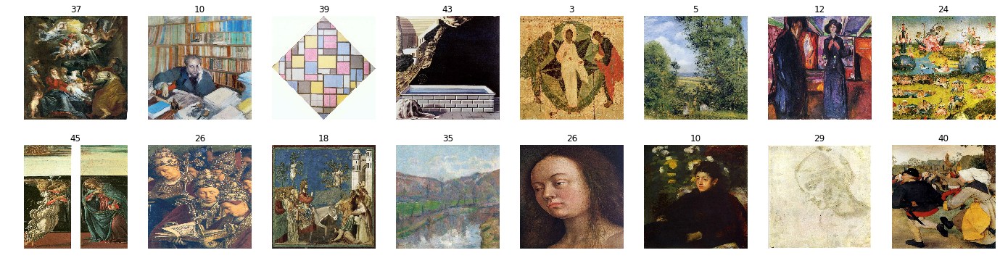

In [0]:
data_container.test.show()

# Helpers

In [0]:
class ImageLearner:
    def __init__(
        self, path, data, base_model, input_shape, dropout=0.0, l1=1e-8, l2=1e-8, override=False, load=False,
    ):
        self.path = str(path)
        self.weights_path = f"{self.path}/weights.h5"
        self.architecture_path = f"{self.path}/model.json"
        self.logs_path = f"{self.path}/logs"

        self.data = data
        self.n_classes = data.train.n_classes
        self.input_shape = input_shape
        self.dropout = dropout
        self.l1 = l1
        self.l2 = l2

        self.base_model = base_model(include_top=False, input_shape=input_shape)
        x = keras.layers.concatenate(
            [
                keras.layers.GlobalAvgPool2D()(self.base_model.output),
                keras.layers.GlobalMaxPool2D()(self.base_model.output),
            ]
        )
        x = keras.layers.BatchNormalization()(x)
        x = keras.layers.Dropout(dropout)(x)
        x = keras.layers.Dense(
            self.n_classes,
            kernel_regularizer=keras.regularizers.l1_l2(l1, l2),
            activation=keras.activations.softmax,
        )(x)

        self.model = keras.Model(inputs=self.base_model.inputs, outputs=x)
        
        if os.path.exists(self.path):
            if load:
                self.load()
            elif override:
                shutil.rmtree(self.path)
                os.makedirs(self.path)
        else:
            os.makedirs(self.path)
            
        self.save()

    def save(self):
        save_keras_model(self.model, self.architecture_path, self.weights_path)

    def load(self, weights_only=False):
        if weights_only:
            self.model.load_weights(self.weights_path)
        else:
            self.model = load_keras_model(self.architecture_path, self.weights_path)

    def compile(self, optimizer, lr):
        self.model.compile(
            optimizer=optimizer(lr),
            loss=keras.losses.sparse_categorical_crossentropy,
            metrics=[keras.metrics.sparse_categorical_accuracy],
        )

    def freeze(self):
        for layer in self.model.layers[:-1]:
            layer.trainable = False

    def unfreeze(self):
        for layer in self.model.layers[:-1]:
            layer.trainable = True

    def train(self, epochs, verbose=1):
        reduce_lr_patience = max(2, epochs // 4)
        early_stopping_patience = reduce_lr_patience * 2

        self.history = self.model.fit(
            x=self.data.train.data,
            steps_per_epoch=self.data.train.steps,
            validation_data=self.data.validation.data,
            validation_steps=self.data.validation.steps,
            epochs=epochs,
            callbacks=[
                keras.callbacks.ModelCheckpoint(
                    self.weights_path, save_best_only=True, save_weights_only=True
                ),
                keras.callbacks.ReduceLROnPlateau(
                    factor=0.3, patience=reduce_lr_patience, 
                ),
                keras.callbacks.EarlyStopping(
                    patience=early_stopping_patience, restore_best_weights=True
                ),
                keras.callbacks.TensorBoard(
                    log_dir=self.logs_path, 
                    histogram_freq=1,
                    write_graph=True,
                    write_images=True,
                    update_freq='batch',
                )
            ],
            verbose=verbose,
        )
        self.load(weights_only=True)

    def evaluate_dataset(self, mode="validation", verbose=1):
        dataset = getattr(self.data, mode)
        return self.model.evaluate(dataset.data, steps=dataset.steps, verbose=verbose)

    def predict_dataset(self, mode="validation", verbose=0):
        dataset = getattr(self.data, mode)
        return self.model.predict(dataset.data, steps=dataset.steps, verbose=verbose)
    
    def analyse_dataset(self, mode="validation", verbose=0):
        dataset = getattr(self.data, mode)
        image_ds = tf.data.Dataset.from_tensor_slices(dataset.x)
        image_ds = dataset.preprocess(image_ds, 1).batch(1)
        images = [img[0].numpy() for img in image_ds.take(dataset.steps * dataset.batch_size)]
        probs = self.model.predict(image_ds)
        preds = probs.argmax(axis=1)
        return pd.DataFrame.from_dict({
            "path": dataset.x,
            "image": images,
            "label": dataset.y, 
            "pred": preds,
            "label_probs": probs[:, dataset.y][np.eye(len(dataset.y), dtype=bool)],
            "pred_probs": probs[:, preds][np.eye(len(preds), dtype=bool)],
        })
    
    def predict(self, path=None, image=None):
        if image is None:
            image = tf.data.Dataset.from_tensor_slices([path])
            image = self.data.test.preprocess(image, 1).batch(1)
        elif image.ndim == 3:
            image = image[np.newaxis, :]
        return self.model.predict(image)
    
    def show_predictions(self, mode="validation", correct: bool = False, ascending: bool = True, cols: int = 8, rows: int = 2):
        df = self.analyse_dataset(mode=mode)
        df = df[(df.label == df.pred) if correct else (df.label != df.pred)]
        df.sort_values(by=["label_probs"], ascending=ascending, inplace=True)
        _, ax = plt.subplots(rows, cols, figsize=(3 * cols, 3.5 * rows))
        for i, row in enumerate(df.head(cols * rows).itertuples()):
            idx = (i // cols, i % cols) if rows > 1 else i % cols
            ax[idx].axis("off")
            ax[idx].imshow(row.image)
            ax[idx].set_title(f"{row.label}:{row.pred}\n{row.label_probs:.4f}:{row.pred_probs:.4f}")
        

    def show_history(self, contains, skip=0):
        history_df = pd.DataFrame(self.history.history)
        history_df[list(history_df.filter(regex=contains))].iloc[skip:].plot()

In [0]:
def train_learner(learner, epochs=(5, 15), lrs=(1e-4, 1e-4), optimizer=keras.optimizers.Adam):
    start_time = time.time()
    learner.freeze()
    learner.compile(optimizer, lrs[0])
    learner.train(epochs[0])
    learner.unfreeze()
    learner.compile(optimizer, lrs[1])
    learner.train(epochs[1])
    end_time = time.time()

    eval_start_time = time.time()
    loss, accuracy = learner.evaluate_dataset(verbose=0)
    eval_end_time = time.time()

    print("-".center(80, "-"))
    print(
        "Name: {} Train Time: {:.1f} min. Eval Time: {:.2f}s Loss: {:.4f} Accuracy: {:.2%}".format(
            learner.base_model.name,
            (end_time - start_time) / 60,
            (eval_end_time - eval_start_time),
            loss,
            accuracy,
        )
    )
    print("-".center(80, "-"))

In [0]:
class ArtsSchool():
    def __init__(
        self, 
        train_df,
        val_df,
        test_df, 
        path, 
        img_dims=(255, 255, 3), 
        batch_size=16, 
        augmentation_level=3,
        base_model=keras.applications.Xception,
        drop_out=0.5,
        load=False
    ):
        self.path = path
        self.img_dims = img_dims
        self.augmentation_level = augmentation_level
        self.drop_out = drop_out

        self.data_container = DataContainer(
            train=ImageDataset(
                x=train_df['path'],
                y=train_df['label'],
                batch_size=batch_size,
                img_dims=img_dims,
                preprocess_pipeline=[
                    ImageParser(),
                    ImageResizer(img_dims=img_dims, resize="random_crop", crop_adjustment=1.6),
                    ImageAugmentor(level=augmentation_level, flips="both"),
                ],
                shuffle=True, 
                prefetch=1,
                num_parallel_calls=-1
            ),
            validation=ImageDataset(
                x=val_df['path'],
                y=val_df['label'],
                batch_size=batch_size,
                img_dims=img_dims,
                preprocess_pipeline=[
                    ImageParser(),
                    ImageResizer(img_dims=img_dims, resize="random_crop", crop_adjustment=1),
                ],
                shuffle=False, 
                prefetch=1,
                num_parallel_calls=-1
            ),
            test=ImageDataset(
                x=test_df['path'],
                y=test_df['label'],
                batch_size=batch_size,
                img_dims=img_dims,
                preprocess_pipeline=[
                    ImageParser(),
                    ImageResizer(img_dims=img_dims, resize="random_crop", crop_adjustment=1),
                ],
                shuffle=False, 
                prefetch=1,
                num_parallel_calls=-1
            )
        )
        self.learner = ImageLearner(
            path=path,
            data=self.data_container,
            base_model=base_model,
            input_shape=img_dims,
            dropout=drop_out,
            l1=3e-5,
            l2=3e-4,
            load=load,
        )
    
    def show_images(self):
        print("Train images")
        self.data_container.train.show()
        print("Validation images")
        self.data_container.validation.show()
        print("Test images")
        self.data_container.test.show()

    def print_model_setup(self):
        print("Model path: {} \n".format(self.path))
        print("Model image size: {}\n".format(self.img_dims))
        print("Model augmentation level: {}\n".format(self.augmentation_level))
        print("Model drop out: {}\n".format(self.drop_out))

    def learn(self, epochs, lrs=(1e-4, 1e-4), optimizer=keras.optimizers.Adam):
        self.print_model_setup()
        print("Freezed ephochs {}, lrs: {}\n".format(epochs[0], lrs[0]))
        print("Full ephochs {}, lrs: {}\n".format(epochs[1], lrs[1]))
        train_learner(self.learner, epochs=epochs, lrs=lrs, optimizer=optimizer)


# Xception

In [0]:
learner = ImageLearner(
    path=TEMP_DIR/"Xception",
    data=data_container,
    base_model=keras.applications.Xception,
    input_shape=IMG_DIMS,
    dropout=0.5,
    l1=3e-5,
    l2=3e-4,
    load=True,
)

83689472/83683744 [==============================] - 5s 0us/step


In [0]:
learner.logs_path = Path('logs')
learner.logs_path.mkdir(parents=True, exist_ok=True)

In [0]:
train_learner(learner, epochs=(5, 15))

W0902 12:22:53.849980 140534201100160 callbacks.py:1467] `write_grads` will be ignored in TensorFlow 2.0 for the `TensorBoard` Callback.
W0902 12:22:53.850929 140534201100160 callbacks.py:1470] `batch_size` is no longer needed in the `TensorBoard` Callback and will be ignored in TensorFlow 2.0.


Epoch 1/5


W0902 12:22:55.031486 140534201100160 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


1689/1689 [==============================] - 335s 198ms/step - loss: 3.0382 - sparse_categorical_accuracy: 0.3504 - val_loss: 3.1627 - val_sparse_categorical_accuracy: 0.2311
Epoch 2/5
1689/1689 [==============================] - 325s 192ms/step - loss: 2.8928 - sparse_categorical_accuracy: 0.3589 - val_loss: 3.3272 - val_sparse_categorical_accuracy: 0.1993
Epoch 3/5
1689/1689 [==============================] - 323s 191ms/step - loss: 2.8622 - sparse_categorical_accuracy: 0.3606 - val_loss: 3.3042 - val_sparse_categorical_accuracy: 0.2028
Epoch 4/5
1689/1689 [==============================] - 323s 191ms/step - loss: 2.7254 - sparse_categorical_accuracy: 0.3804 - val_loss: 3.2100 - val_sparse_categorical_accuracy: 0.2241
Epoch 5/5
1689/1689 [==============================] - 323s 191ms/step - loss: 2.6795 - sparse_categorical_accuracy: 0.3921 - val_loss: 3.2091 - val_sparse_categorical_accuracy: 0.2017


W0902 12:50:11.383474 140534201100160 callbacks.py:1467] `write_grads` will be ignored in TensorFlow 2.0 for the `TensorBoard` Callback.
W0902 12:50:11.384525 140534201100160 callbacks.py:1470] `batch_size` is no longer needed in the `TensorBoard` Callback and will be ignored in TensorFlow 2.0.


Epoch 1/15
1689/1689 [==============================] - 1128s 668ms/step - loss: 2.7187 - sparse_categorical_accuracy: 0.3807 - val_loss: 2.2544 - val_sparse_categorical_accuracy: 0.4894
Epoch 2/15
1689/1689 [==============================] - 1064s 630ms/step - loss: 2.2040 - sparse_categorical_accuracy: 0.4702 - val_loss: 1.9891 - val_sparse_categorical_accuracy: 0.5660
Epoch 3/15
1689/1689 [==============================] - 1057s 626ms/step - loss: 1.9798 - sparse_categorical_accuracy: 0.5167 - val_loss: 1.8135 - val_sparse_categorical_accuracy: 0.5943
Epoch 4/15
1689/1689 [==============================] - 1069s 633ms/step - loss: 1.7904 - sparse_categorical_accuracy: 0.5520 - val_loss: 2.0431 - val_sparse_categorical_accuracy: 0.5861
Epoch 5/15
1689/1689 [==============================] - 1073s 636ms/step - loss: 1.6580 - sparse_categorical_accuracy: 0.5867 - val_loss: 1.8961 - val_sparse_categorical_accuracy: 0.5932
Epoch 6/15
1689/1689 [==============================] - 1066s 631

In [0]:
%tensorboard --logdir {learner.logs_path}

Reusing TensorBoard on port 6006 (pid 519), started 5:10:42 ago. (Use '!kill 519' to kill it.)

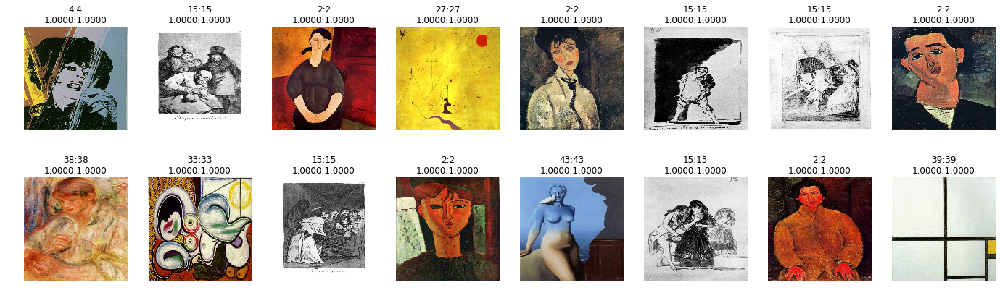

In [0]:
learner.show_predictions(correct=True, ascending=False)

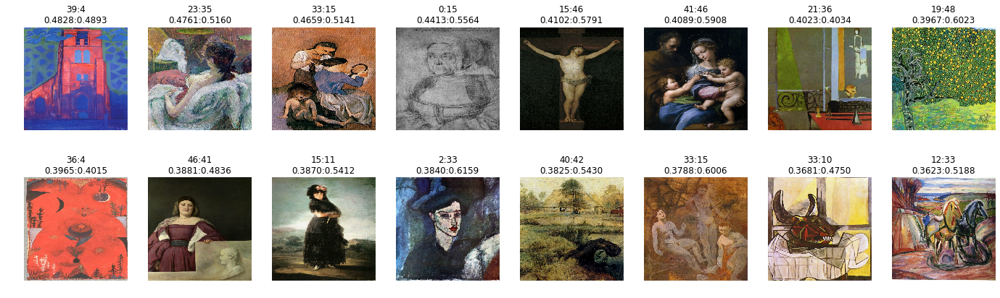

In [0]:
learner.show_predictions(correct=False, ascending=False)

# ResNet50

In [0]:
Epoch 1/5
WARNING: Logging before flag parsing goes to stderr.
W0903 05:53:06.673085 139999960979328 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
  1/845 [..............................] - ETA: 1:38:20 - loss: 4.8546 - sparse_categorical_accuracy: 0.0000e+00W0903 05:53:13.512341 139999960979328 callbacks.py:241] Method (on_train_batch_end) is slow compared to the batch update (0.342016). Check your callbacks.
  2/845 [..............................] - ETA: 51:14 - loss: 5.7900 - sparse_categorical_accuracy: 0.0000e+00  W0903 05:53:13.631783 139999960979328 callbacks.py:241] Method (on_train_batch_end) is slow compared to the batch update (0.131301). Check your callbacks.
845/845 [==============================] - 167s 197ms/step - loss: 4.0200 - sparse_categorical_accuracy: 0.1778 - val_loss: 7.7180 - val_sparse_categorical_accuracy: 0.0200
Epoch 2/5
845/845 [==============================] - 158s 187ms/step - loss: 3.0079 - sparse_categorical_accuracy: 0.3266 - val_loss: 7.7441 - val_sparse_categorical_accuracy: 0.0283
Epoch 3/5
845/845 [==============================] - 156s 185ms/step - loss: 2.6804 - sparse_categorical_accuracy: 0.3899 - val_loss: 8.2192 - val_sparse_categorical_accuracy: 0.0377
Epoch 4/5
845/845 [==============================] - 157s 186ms/step - loss: 2.4960 - sparse_categorical_accuracy: 0.4155 - val_loss: 8.2812 - val_sparse_categorical_accuracy: 0.0200
Epoch 5/5
845/845 [==============================] - 157s 185ms/step - loss: 2.4384 - sparse_categorical_accuracy: 0.4297 - val_loss: 8.3613 - val_sparse_categorical_accuracy: 0.0224
Epoch 1/15
845/845 [==============================] - 359s 425ms/step - loss: 3.0591 - sparse_categorical_accuracy: 0.3343 - val_loss: 6.3270 - val_sparse_categorical_accuracy: 0.1580
Epoch 2/15
845/845 [==============================] - 315s 372ms/step - loss: 2.6100 - sparse_categorical_accuracy: 0.4056 - val_loss: 2.0288 - val_sparse_categorical_accuracy: 0.5389
Epoch 3/15
845/845 [==============================] - 308s 364ms/step - loss: 2.3530 - sparse_categorical_accuracy: 0.4592 - val_loss: 2.3391 - val_sparse_categorical_accuracy: 0.4941
Epoch 4/15
845/845 [==============================] - 306s 363ms/step - loss: 2.2342 - sparse_categorical_accuracy: 0.4837 - val_loss: 2.5813 - val_sparse_categorical_accuracy: 0.4764
Epoch 5/15
845/845 [==============================] - 306s 362ms/step - loss: 2.0601 - sparse_categorical_accuracy: 0.5104 - val_loss: 2.3781 - val_sparse_categorical_accuracy: 0.5248
Epoch 6/15
845/845 [==============================] - 309s 365ms/step - loss: 1.6726 - sparse_categorical_accuracy: 0.5956 - val_loss: 1.5982 - val_sparse_categorical_accuracy: 0.6297
Epoch 7/15
845/845 [==============================] - 307s 363ms/step - loss: 1.4919 - sparse_categorical_accuracy: 0.6317 - val_loss: 1.5462 - val_sparse_categorical_accuracy: 0.6474
Epoch 8/15
845/845 [==============================] - 306s 362ms/step - loss: 1.3757 - sparse_categorical_accuracy: 0.6503 - val_loss: 1.4734 - val_sparse_categorical_accuracy: 0.6710
Epoch 9/15
845/845 [==============================] - 308s 364ms/step - loss: 1.3308 - sparse_categorical_accuracy: 0.6676 - val_loss: 1.3954 - val_sparse_categorical_accuracy: 0.6875
Epoch 10/15
845/845 [==============================] - 308s 365ms/step - loss: 1.2261 - sparse_categorical_accuracy: 0.6997 - val_loss: 1.3711 - val_sparse_categorical_accuracy: 0.6958
Epoch 11/15
845/845 [==============================] - 306s 362ms/step - loss: 1.1966 - sparse_categorical_accuracy: 0.7012 - val_loss: 1.4365 - val_sparse_categorical_accuracy: 0.6781
Epoch 12/15
845/845 [==============================] - 307s 363ms/step - loss: 1.1372 - sparse_categorical_accuracy: 0.7098 - val_loss: 1.4995 - val_sparse_categorical_accuracy: 0.6509
Epoch 13/15
845/845 [==============================] - 306s 362ms/step - loss: 1.0657 - sparse_categorical_accuracy: 0.7317 - val_loss: 1.5067 - val_sparse_categorical_accuracy: 0.6580
Epoch 14/15
845/845 [==============================] - 308s 364ms/step - loss: 0.9656 - sparse_categorical_accuracy: 0.7547 - val_loss: 1.3054 - val_sparse_categorical_accuracy: 0.7005
Epoch 15/15
845/845 [==============================] - 308s 364ms/step - loss: 0.8973 - sparse_categorical_accuracy: 0.7716 - val_loss: 1.3476 - val_sparse_categorical_accuracy: 0.6934
--------------------------------------------------------------------------------
Name: resnet50 Train Time: 91.8 min. Eval Time: 11.49s Loss: 1.3054 Accuracy: 70.05%

# HP tuning

In [0]:
dimensions = [
    skopt.space.Categorical([
        keras.optimizers.Adam,
        keras.optimizers.Nadam,
        keras.optimizers.RMSprop,
    ], name='optimizer'),
    skopt.space.Real(low=1e-8, high=1e-2, prior='log-uniform', name='l1_reg'),
    skopt.space.Real(low=1e-8, high=1e-2, prior='log-uniform', name='l2_reg'),
]

default_parameters = [keras.optimizers.Adam, 1e-8, 1e-8]

In [0]:
best_accuracy = 0.0

In [0]:
@skopt.utils.use_named_args(dimensions=dimensions)
def fitness(
    optimizer,
    l1_reg,
    l2_reg
):  
    learner = ImageLearner(
        path=TEMP_DIR/"HPTuning",
        data=data_container,
        base_model=keras.applications.Xception,
        input_shape=IMG_DIMS,
        dropout=0.5,
        l1=l1_reg,
        l2=l2_reg,
        load=False,
    )   
    train_learner(learner, epochs=(5, 15), lrs=(1e-5, 1e-5), optimizer=optimizer)

    loss, accuracy = learner.evaluate_dataset(verbose=0)

    print("\nAccuracy: {0:.2%}\n".format(accuracy))

    global best_accuracy

    if accuracy > best_accuracy:
        print('Best model'.center(80, '-'))
        print("Accuracy: {0:.4%}".format(accuracy))
        print(
            optimizer,
            l1_reg,
            l2_reg
        )
        learner.save()
        best_accuracy = accuracy

    del learner
    keras.backend.clear_session()
    return -accuracy

In [0]:
search_result = skopt.gp_minimize(
    func=fitness,
    dimensions=dimensions,
    acq_func='EI',
    n_calls=15,
    x0=default_parameters,
)

Epoch 1/5
1689/1689 [==============================] - 334s 198ms/step - loss: 4.9138 - sparse_categorical_accuracy: 0.0441 - val_loss: 3.8877 - val_sparse_categorical_accuracy: 0.0767
Epoch 2/5
1689/1689 [==============================] - 328s 194ms/step - loss: 4.6983 - sparse_categorical_accuracy: 0.0557 - val_loss: 3.7596 - val_sparse_categorical_accuracy: 0.1050
Epoch 3/5
1689/1689 [==============================] - 328s 194ms/step - loss: 4.5875 - sparse_categorical_accuracy: 0.0645 - val_loss: 3.6453 - val_sparse_categorical_accuracy: 0.1285
Epoch 4/5
1689/1689 [==============================] - 325s 192ms/step - loss: 4.5038 - sparse_categorical_accuracy: 0.0694 - val_loss: 3.5467 - val_sparse_categorical_accuracy: 0.1427
Epoch 5/5
1689/1689 [==============================] - 330s 195ms/step - loss: 4.3851 - sparse_categorical_accuracy: 0.0774 - val_loss: 3.4533 - val_sparse_categorical_accuracy: 0.1568
Epoch 1/15
1689/1689 [==============================] - 1120s 663ms/step - 

In [0]:
{key.name: value for key, value in zip(dimensions, search_result.x)}

# Manual HP tuning

**Try basic parameters:**

1. Reducing image_dims to speedup learning.
2. Increasing learning rate.
3. Removing augmentation
4. Removing drop_out

In [18]:
arts = ArtsSchool(
    train_df,
    val_df, 
    test_df, 
    path=TEMP_DIR/"m1", 
    img_dims=(71, 71, 3), 
    batch_size=62,
    augmentation_level=0, 
    base_model=tf.keras.applications.Xception,
    drop_out=0.0,
    load=False
)
arts.learn(epochs=(5, 5), lrs=(1e-3, 1e-3), optimizer=keras.optimizers.Adam)

83689472/83683744 [==============================] - 1s 0us/step
Model path: /content/drive/My Drive/Colab Notebooks/temp/artworks/m1 

Model image size: (71, 71, 3)

Model augmentation level: 0

Model drop out: 0.0

Freezed ephochs 5, lrs: 0.001

Full ephochs 5, lrs: 0.001

Epoch 1/5


W0905 07:54:02.566633 140409590863744 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


  1/109 [..............................] - ETA: 14:03 - loss: 4.1117 - sparse_categorical_accuracy: 0.0323

W0905 07:54:09.178732 140409590863744 callbacks.py:241] Method (on_train_batch_end) is slow compared to the batch update (0.251384). Check your callbacks.


  2/109 [..............................] - ETA: 7:20 - loss: 4.1193 - sparse_categorical_accuracy: 0.0323 

W0905 07:54:09.819329 140409590863744 callbacks.py:241] Method (on_train_batch_end) is slow compared to the batch update (0.246484). Check your callbacks.


109/109 [==============================] - 107s 985ms/step - loss: 3.8940 - sparse_categorical_accuracy: 0.1384 - val_loss: 3.7476 - val_sparse_categorical_accuracy: 0.1394
Epoch 2/5
109/109 [==============================] - 96s 878ms/step - loss: 3.5111 - sparse_categorical_accuracy: 0.2103 - val_loss: 3.7920 - val_sparse_categorical_accuracy: 0.1521
Epoch 3/5
109/109 [==============================] - 94s 866ms/step - loss: 3.4111 - sparse_categorical_accuracy: 0.2186 - val_loss: 3.7960 - val_sparse_categorical_accuracy: 0.1567
Epoch 4/5
109/109 [==============================] - 98s 900ms/step - loss: 3.1946 - sparse_categorical_accuracy: 0.2453 - val_loss: 3.7057 - val_sparse_categorical_accuracy: 0.1694
Epoch 5/5
109/109 [==============================] - 97s 885ms/step - loss: 3.1378 - sparse_categorical_accuracy: 0.2592 - val_loss: 3.6986 - val_sparse_categorical_accuracy: 0.1797
Epoch 1/5
109/109 [==============================] - 149s 1s/step - loss: 3.2884 - sparse_categoric

Unfreezed model loses accuracy after several epochs

1. Increasing drop out
2. Increasing augmentation

In [0]:
Model path: /content/drive/My Drive/Colab Notebooks/temp/artworks/m2 

Model image size: (71, 71, 3)

Model augmentation level: 3

Model drop out: 0.3

Freezed ephochs 5, lrs: 0.001

Full ephochs 5, lrs: 0.001

Epoch 1/5
WARNING: Logging before flag parsing goes to stderr.
W0905 08:00:59.499021 139813702535040 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
109/109 [==============================] - 108s 987ms/step - loss: 4.0305 - sparse_categorical_accuracy: 0.1172 - val_loss: 3.8615 - val_sparse_categorical_accuracy: 0.1129
Epoch 2/5
109/109 [==============================] - 100s 913ms/step - loss: 3.6560 - sparse_categorical_accuracy: 0.1716 - val_loss: 3.8495 - val_sparse_categorical_accuracy: 0.1452
Epoch 3/5
109/109 [==============================] - 100s 913ms/step - loss: 3.5348 - sparse_categorical_accuracy: 0.2055 - val_loss: 3.7639 - val_sparse_categorical_accuracy: 0.1636
Epoch 4/5
109/109 [==============================] - 97s 894ms/step - loss: 3.4686 - sparse_categorical_accuracy: 0.2070 - val_loss: 3.9673 - val_sparse_categorical_accuracy: 0.1509
Epoch 5/5
109/109 [==============================] - 97s 888ms/step - loss: 3.4334 - sparse_categorical_accuracy: 0.2178 - val_loss: 3.9062 - val_sparse_categorical_accuracy: 0.1740
Epoch 1/5
109/109 [==============================] - 149s 1s/step - loss: 3.7057 - sparse_categorical_accuracy: 0.1406 - val_loss: 3.4797 - val_sparse_categorical_accuracy: 0.1786
Epoch 2/5
109/109 [==============================] - 118s 1s/step - loss: 3.0138 - sparse_categorical_accuracy: 0.2871 - val_loss: 3.2284 - val_sparse_categorical_accuracy: 0.1855
Epoch 3/5
109/109 [==============================] - 116s 1s/step - loss: 2.8247 - sparse_categorical_accuracy: 0.3356 - val_loss: 5.9622 - val_sparse_categorical_accuracy: 0.1071
Epoch 4/5
109/109 [==============================] - 116s 1s/step - loss: 3.1148 - sparse_categorical_accuracy: 0.2711 - val_loss: 14.1653 - val_sparse_categorical_accuracy: 0.0300
Epoch 5/5
109/109 [==============================] - 116s 1s/step - loss: 2.9353 - sparse_categorical_accuracy: 0.2888 - val_loss: 3.4456 - val_sparse_categorical_accuracy: 0.2972
--------------------------------------------------------------------------------
Name: xception Train Time: 19.1 min. Eval Time: 10.76s Loss: 3.2284 Accuracy: 18.55%
--------------------------------------------------------------------------------

Looks like loss increasing and accuracy decreasing after several epochs. Also difference between training and validation accuraccy inscreasing. 

Things to try:
1. Reduce learning rate to reduce 
2. Increase augmentation and dropout

In [0]:
Model path: /content/drive/My Drive/Colab Notebooks/temp/artworks/m2 

Model image size: (71, 71, 3)

Model augmentation level: 5

Model drop out: 0.5

Freezed ephochs 5, lrs: 1e-05

Full ephochs 5, lrs: 1e-05

Epoch 1/5
109/109 [==============================] - 104s 953ms/step - loss: 4.3733 - sparse_categorical_accuracy: 0.0231 - val_loss: 4.1678 - val_sparse_categorical_accuracy: 0.0230
Epoch 2/5
109/109 [==============================] - 100s 916ms/step - loss: 4.2393 - sparse_categorical_accuracy: 0.0392 - val_loss: 4.0949 - val_sparse_categorical_accuracy: 0.0288
Epoch 3/5
109/109 [==============================] - 100s 916ms/step - loss: 4.1937 - sparse_categorical_accuracy: 0.0460 - val_loss: 4.0661 - val_sparse_categorical_accuracy: 0.0300
Epoch 4/5
109/109 [==============================] - 100s 913ms/step - loss: 4.1758 - sparse_categorical_accuracy: 0.0465 - val_loss: 4.0468 - val_sparse_categorical_accuracy: 0.0380
Epoch 5/5
109/109 [==============================] - 100s 920ms/step - loss: 4.1654 - sparse_categorical_accuracy: 0.0509 - val_loss: 4.0321 - val_sparse_categorical_accuracy: 0.0369
Epoch 1/5
109/109 [==============================] - 167s 2s/step - loss: 5.3267 - sparse_categorical_accuracy: 0.0272 - val_loss: 4.1194 - val_sparse_categorical_accuracy: 0.0484
Epoch 2/5
109/109 [==============================] - 117s 1s/step - loss: 5.0488 - sparse_categorical_accuracy: 0.0431 - val_loss: 4.0721 - val_sparse_categorical_accuracy: 0.0691
Epoch 3/5
109/109 [==============================] - 119s 1s/step - loss: 4.8246 - sparse_categorical_accuracy: 0.0545 - val_loss: 3.9948 - val_sparse_categorical_accuracy: 0.0853
Epoch 4/5
109/109 [==============================] - 116s 1s/step - loss: 4.6966 - sparse_categorical_accuracy: 0.0576 - val_loss: 4.0007 - val_sparse_categorical_accuracy: 0.1118
Epoch 5/5
109/109 [==============================] - 116s 1s/step - loss: 4.6207 - sparse_categorical_accuracy: 0.0762 - val_loss: 3.9972 - val_sparse_categorical_accuracy: 0.1164
--------------------------------------------------------------------------------
Name: xception Train Time: 19.2 min. Eval Time: 10.74s Loss: 3.9948 Accuracy: 8.53%

After 5+5 epochs accuracy is worse. However, training and validation lesses constantly going down and accuracy increasing. 

**Next:** 
1. Increase image_dims 

In [22]:
arts2 = ArtsSchool(
    train_df,
    val_df, 
    test_df, 
    path=TEMP_DIR/"m2", 
    img_dims=(299, 299, 3), 
    batch_size=16,
    augmentation_level=5, 
    base_model=tf.keras.applications.Xception,
    drop_out=0.5,
    load=False
)
arts2.learn(epochs=(5, 5), lrs=(1e-5, 1e-5), optimizer=keras.optimizers.Adam)

Model path: /content/drive/My Drive/Colab Notebooks/temp/artworks/m2 

Model image size: (299, 299, 3)

Model augmentation level: 5

Model drop out: 0.5

Freezed ephochs 5, lrs: 1e-05

Full ephochs 5, lrs: 1e-05

Epoch 1/5


W0905 10:31:16.609079 139940699309952 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


423/423 [==============================] - 244s 577ms/step - loss: 5.4264 - sparse_categorical_accuracy: 0.0366 - val_loss: 4.0711 - val_sparse_categorical_accuracy: 0.0908
Epoch 2/5
423/423 [==============================] - 233s 550ms/step - loss: 5.0753 - sparse_categorical_accuracy: 0.0530 - val_loss: 3.9653 - val_sparse_categorical_accuracy: 0.0943
Epoch 3/5
423/423 [==============================] - 232s 548ms/step - loss: 4.9822 - sparse_categorical_accuracy: 0.0504 - val_loss: 3.8750 - val_sparse_categorical_accuracy: 0.1061
Epoch 4/5
423/423 [==============================] - 233s 551ms/step - loss: 4.8937 - sparse_categorical_accuracy: 0.0597 - val_loss: 3.7939 - val_sparse_categorical_accuracy: 0.1167
Epoch 5/5
423/423 [==============================] - 232s 550ms/step - loss: 4.8168 - sparse_categorical_accuracy: 0.0706 - val_loss: 3.7102 - val_sparse_categorical_accuracy: 0.1321
Epoch 1/5
423/423 [==============================] - 816s 2s/step - loss: 4.5374 - sparse_categ

Lets run more epoch with the same parameters

In [0]:
Model path: /content/drive/My Drive/Colab Notebooks/temp/artworks/final 

Model image size: (299, 299, 3)

Model augmentation level: 5

Model drop out: 0.5

Freezed ephochs 10, lrs: 1e-05

Full ephochs 15, lrs: 1e-05

Epoch 1/10
423/423 [==============================] - 237s 560ms/step - loss: 5.2786 - sparse_categorical_accuracy: 0.0396 - val_loss: 4.0518 - val_sparse_categorical_accuracy: 0.0672
Epoch 2/10
423/423 [==============================] - 233s 550ms/step - loss: 4.9980 - sparse_categorical_accuracy: 0.0548 - val_loss: 3.9580 - val_sparse_categorical_accuracy: 0.0767
Epoch 3/10
423/423 [==============================] - 232s 549ms/step - loss: 4.9692 - sparse_categorical_accuracy: 0.0553 - val_loss: 3.8692 - val_sparse_categorical_accuracy: 0.0979
Epoch 4/10
423/423 [==============================] - 231s 547ms/step - loss: 4.8404 - sparse_categorical_accuracy: 0.0634 - val_loss: 3.7856 - val_sparse_categorical_accuracy: 0.1156
Epoch 5/10
423/423 [==============================] - 233s 550ms/step - loss: 4.7654 - sparse_categorical_accuracy: 0.0690 - val_loss: 3.7081 - val_sparse_categorical_accuracy: 0.1333
Epoch 6/10
423/423 [==============================] - 234s 553ms/step - loss: 4.6544 - sparse_categorical_accuracy: 0.0802 - val_loss: 3.6356 - val_sparse_categorical_accuracy: 0.1498
Epoch 7/10
423/423 [==============================] - 234s 552ms/step - loss: 4.5823 - sparse_categorical_accuracy: 0.0799 - val_loss: 3.5704 - val_sparse_categorical_accuracy: 0.1639
Epoch 8/10
423/423 [==============================] - 233s 550ms/step - loss: 4.5223 - sparse_categorical_accuracy: 0.0888 - val_loss: 3.5066 - val_sparse_categorical_accuracy: 0.1769
Epoch 9/10
423/423 [==============================] - 233s 551ms/step - loss: 4.4528 - sparse_categorical_accuracy: 0.0966 - val_loss: 3.4513 - val_sparse_categorical_accuracy: 0.1910
Epoch 10/10
423/423 [==============================] - 233s 550ms/step - loss: 4.4195 - sparse_categorical_accuracy: 0.0965 - val_loss: 3.3945 - val_sparse_categorical_accuracy: 0.2005
Epoch 1/15
423/423 [==============================] - 859s 2s/step - loss: 4.0301 - sparse_categorical_accuracy: 0.1582 - val_loss: 3.0357 - val_sparse_categorical_accuracy: 0.2948
Epoch 2/15
423/423 [==============================] - 785s 2s/step - loss: 3.5386 - sparse_categorical_accuracy: 0.2401 - val_loss: 2.7231 - val_sparse_categorical_accuracy: 0.3597
Epoch 3/15
423/423 [==============================] - 786s 2s/step - loss: 3.2296 - sparse_categorical_accuracy: 0.2939 - val_loss: 2.4802 - val_sparse_categorical_accuracy: 0.3986
Epoch 4/15
423/423 [==============================] - 792s 2s/step - loss: 2.9925 - sparse_categorical_accuracy: 0.3316 - val_loss: 2.3010 - val_sparse_categorical_accuracy: 0.4399
Epoch 5/15
423/423 [==============================] - 788s 2s/step - loss: 2.7887 - sparse_categorical_accuracy: 0.3720 - val_loss: 2.1466 - val_sparse_categorical_accuracy: 0.4800
Epoch 6/15
423/423 [==============================] - 786s 2s/step - loss: 2.6255 - sparse_categorical_accuracy: 0.3920 - val_loss: 2.0275 - val_sparse_categorical_accuracy: 0.5165
Epoch 7/15
423/423 [==============================] - 787s 2s/step - loss: 2.4819 - sparse_categorical_accuracy: 0.4229 - val_loss: 1.9291 - val_sparse_categorical_accuracy: 0.5354
Epoch 8/15
423/423 [==============================] - 787s 2s/step - loss: 2.3493 - sparse_categorical_accuracy: 0.4478 - val_loss: 1.8466 - val_sparse_categorical_accuracy: 0.5531
Epoch 9/15
423/423 [==============================] - 788s 2s/step - loss: 2.2452 - sparse_categorical_accuracy: 0.4690 - val_loss: 1.7797 - val_sparse_categorical_accuracy: 0.5672
Epoch 10/15
423/423 [==============================] - 786s 2s/step - loss: 2.1358 - sparse_categorical_accuracy: 0.4954 - val_loss: 1.7345 - val_sparse_categorical_accuracy: 0.5825
Epoch 11/15
423/423 [==============================] - 786s 2s/step - loss: 2.0105 - sparse_categorical_accuracy: 0.5137 - val_loss: 1.6552 - val_sparse_categorical_accuracy: 0.6038
Epoch 12/15
423/423 [==============================] - 784s 2s/step - loss: 1.9827 - sparse_categorical_accuracy: 0.5179 - val_loss: 1.6144 - val_sparse_categorical_accuracy: 0.6179
Epoch 13/15
423/423 [==============================] - 785s 2s/step - loss: 1.8819 - sparse_categorical_accuracy: 0.5477 - val_loss: 1.5775 - val_sparse_categorical_accuracy: 0.6238
Epoch 14/15
423/423 [==============================] - 785s 2s/step - loss: 1.8249 - sparse_categorical_accuracy: 0.5541 - val_loss: 1.5512 - val_sparse_categorical_accuracy: 0.6333
Epoch 15/15
423/423 [==============================] - 789s 2s/step - loss: 1.7621 - sparse_categorical_accuracy: 0.5734 - val_loss: 1.5008 - val_sparse_categorical_accuracy: 0.6439
--------------------------------------------------------------------------------
Name: xception Train Time: 236.8 min. Eval Time: 23.50s Loss: 1.5008 Accuracy: 64.39%
--------------------------------------------------------------------------------